### CP 3.1
- applying basic CPD methods
- example of clustering

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import itertools


# для создания графа
import networkx as nx

# для сохранения полученных файлов
import pickle

%config InlineBackend.figure_format = 'retina'

# для записи и сохранения файлов
import os
import pickle
from tqdm import tqdm

**The purpose of this work is to test the operation of CPD methods on graphs.**

**Before using more complex methods, let’s consider how the basic disorder detection method works on the Laplacian of a graph.**

*Briefly about Laplassian*:
- The Laplace matrix of a graph (`L`) is defined as the difference between the diagonal degree matrix (`D`) and the adjacency matrix (`A`):
`L = D - A`
- The diagonal degree matrix (`D`) contains the degrees of the graph nodes (the number of edges connecting each node).
- The adjacency matrix (`A`) contains information about the presence of connections between the nodes of the graph.

**Eigenvalues ​​of the Laplacian (**spectrum**) contain information about the structure of the graph.**
**A zero eigenvalue indicates the graph is connected.**

As statistics, we will consider the eigenvalues ​​of the Laplacian: the first and second largest for each moment in time

#### Laplacian calculation

/opt/anaconda3/lib/python3.11/site-packages/matplotlib/cbook.py:1699: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/opt/anaconda3/lib/python3.11/site-packages/matplotlib/cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


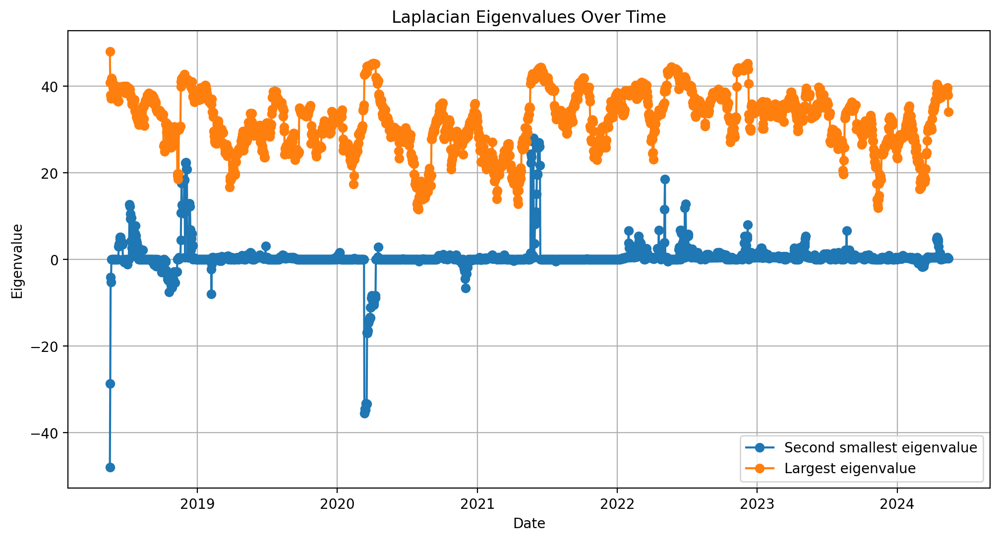

In [92]:

def calculate_laplacian_statistics(G):
    L = nx.laplacian_matrix(G).toarray()
    eigenvalues = np.linalg.eigvals(L)
    return {
        "Laplacian": L,
        "Eigenvalues": eigenvalues,
        "Second smallest eigenvalue": np.partition(eigenvalues, 1)[1], 
        "Largest eigenvalue": np.max(eigenvalues)
    }

def load_graphs_from_files(pkl_files):
    graphs = {}
    laplacian_stats = {}
    for file in pkl_files:
        date_str = file.split('_')[-1].replace('.pkl', '')
        date = pd.to_datetime(date_str).date()
        with open(os.path.join('graphs', file), 'rb') as f:
            data = pickle.load(f)
            G = data["graph"]
            graphs[date] = G
            laplacian_stats[date] = calculate_laplacian_statistics(G)
    return graphs, laplacian_stats


def plot_laplacian_statistics(laplacian_stats):
    dates = sorted(laplacian_stats.keys())
    second_smallest_eigenvalues = [laplacian_stats[date]["Second smallest eigenvalue"] for date in dates]
    largest_eigenvalues = [laplacian_stats[date]["Largest eigenvalue"] for date in dates]
    
    plt.figure(figsize=(12, 6))
    plt.plot(dates, second_smallest_eigenvalues, marker='o', label='Second smallest eigenvalue')
    plt.plot(dates, largest_eigenvalues, marker='o', label='Largest eigenvalue')
    plt.xlabel('Date')
    plt.ylabel('Eigenvalue')
    plt.title('Laplacian Eigenvalues Over Time')
    plt.legend()
    plt.grid(True)
    plt.show()

pkl_files = [file for file in os.listdir('graphs') if file.endswith('.pkl')]
sorted_pkl_files = sorted(pkl_files)

files = []
for file in sorted_pkl_files:
    date_str = file.split('_')[-1].replace('.pkl', '')
    date = pd.to_datetime(date_str)
    # если смотрим только на 1 число каждого месяца
    # if date.day == 1:
    files.append(file)


graphs, laplacian_stats = load_graphs_from_files(files)
plot_laplacian_statistics(laplacian_stats)


**If you compare the behavior of the Laplacian statistics with the behavior of the statistics of the original graph, you can see the similarity of the peaks (especially for the largest eigenvalue)**

### The basic CPD methods using the library [ruptures](https://centre-borelli.github.io/ruptures-docs/)

In [95]:
# !pip install ruptures

/tmp/ipykernel_59907/1717643936.py:54: ComplexWarning: Casting complex values to real discards the imaginary part
  second_smallest_eigenvalues = np.array(second_smallest_eigenvalues).astype(float)
/tmp/ipykernel_59907/1717643936.py:55: ComplexWarning: Casting complex values to real discards the imaginary part
  largest_eigenvalues = np.array(largest_eigenvalues).astype(float)
/tmp/ipykernel_59907/1717643936.py:56: ComplexWarning: Casting complex values to real discards the imaginary part
  spectral_gaps = np.array(spectral_gaps).astype(float)


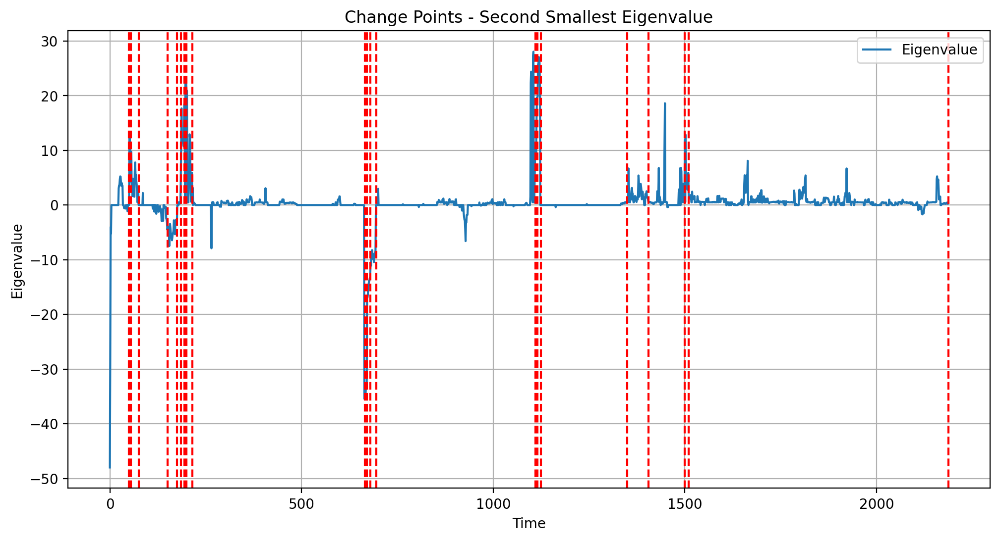

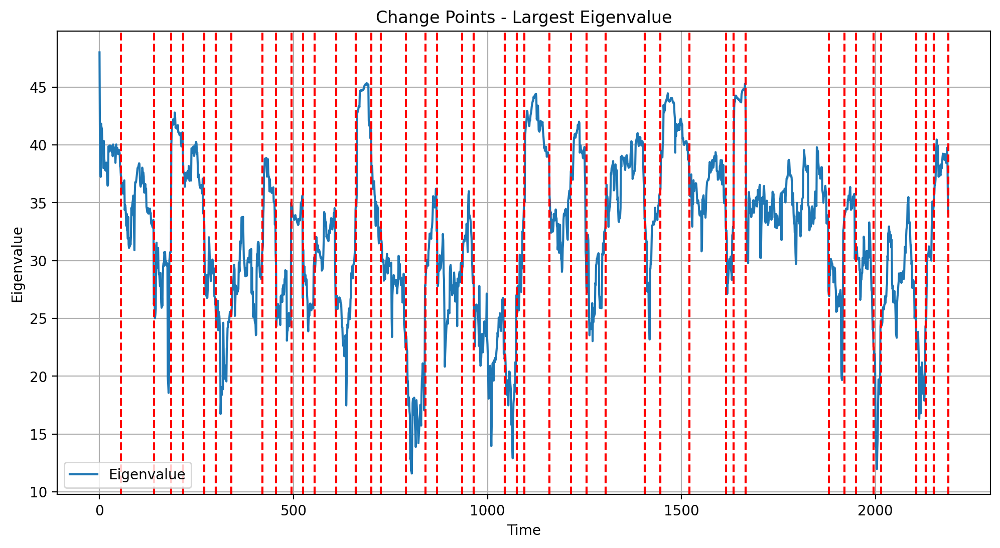

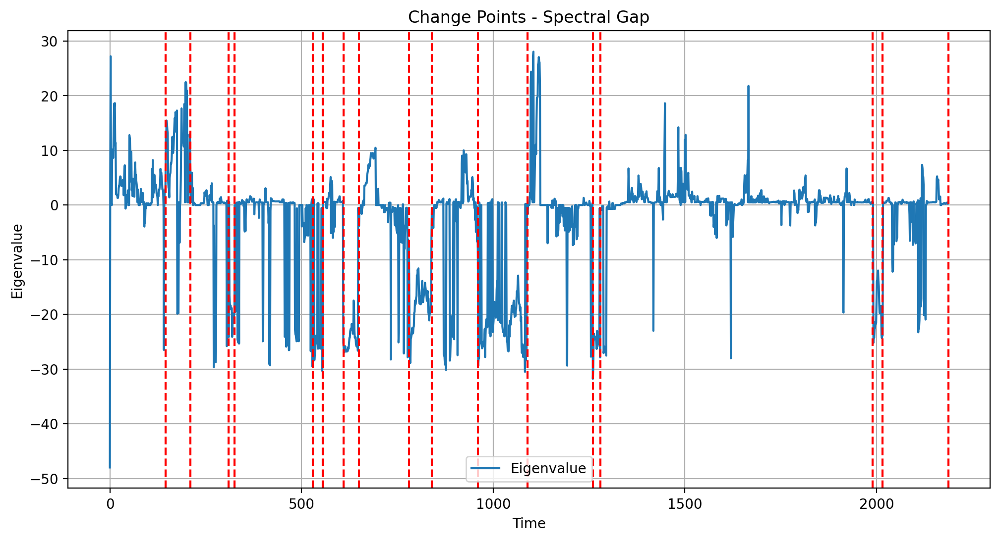

In [117]:
import ruptures as rpt

# Функция для расчета Лапласиана и возврата его статистик
def calculate_laplacian_statistics(G):
    L = nx.laplacian_matrix(G).toarray()
    eigenvalues = np.linalg.eigvals(L)
    return {
        "Laplacian": L,
        "Eigenvalues": eigenvalues,
        "Second smallest eigenvalue": np.partition(eigenvalues, 1)[1],  
        "Largest eigenvalue": np.max(eigenvalues),
        "Spectral gap": np.partition(eigenvalues, 1)[1] - eigenvalues[0]  
    }


def load_graphs_and_laplacian_stats(pkl_files):
    graphs = {}
    laplacian_stats = {}
    for file in pkl_files:
        date_str = file.split('_')[-1].replace('.pkl', '')
        date = pd.to_datetime(date_str).date()
        with open(os.path.join('graphs', file), 'rb') as f:
            data = pickle.load(f)
            G = data["graph"]
            graphs[date] = G
            laplacian_stats[date] = calculate_laplacian_statistics(G)
    return graphs, laplacian_stats


def plot_change_points(signal, change_points, title):
    plt.figure(figsize=(12, 6))
    plt.plot(signal, label="Eigenvalue")
    for cp in change_points:
        plt.axvline(cp, color='r', linestyle='--')
    plt.xlabel('Time')
    plt.ylabel('Eigenvalue')
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()


def apply_cpd(laplacian_stats):
    dates = sorted(laplacian_stats.keys())
    second_smallest_eigenvalues = [laplacian_stats[date]["Second smallest eigenvalue"] for date in dates]
    largest_eigenvalues = [laplacian_stats[date]["Largest eigenvalue"] for date in dates]
    spectral_gaps = [laplacian_stats[date]["Spectral gap"] for date in dates]

    
    # second_smallest_eigenvalues = np.array(second_smallest_eigenvalues)
    # largest_eigenvalues = np.array(largest_eigenvalues)
    # spectral_gaps = np.array(spectral_gaps)

    second_smallest_eigenvalues = np.array(second_smallest_eigenvalues).astype(float)
    largest_eigenvalues = np.array(largest_eigenvalues).astype(float)
    spectral_gaps = np.array(spectral_gaps).astype(float)




    
    algo = rpt.Pelt(model="l1").fit(second_smallest_eigenvalues)
    penalty = np.var(second_smallest_eigenvalues)
    change_points_fiedler = algo.predict(pen=penalty)
    
    algo = rpt.Pelt(model="l1").fit(largest_eigenvalues)
    penalty = np.var(largest_eigenvalues)
    change_points_largest = algo.predict(pen=penalty)
    
    algo = rpt.Pelt(model="l1").fit(spectral_gaps)
    penalty = np.var(spectral_gaps)
    change_points_spectral_gap = algo.predict(pen=penalty)
    
    
    plot_change_points(second_smallest_eigenvalues, change_points_fiedler, "Change Points - Second Smallest Eigenvalue")
    plot_change_points(largest_eigenvalues, change_points_largest, "Change Points - Largest Eigenvalue")
    plot_change_points(spectral_gaps, change_points_spectral_gap, "Change Points - Spectral Gap")


pkl_files = [file for file in os.listdir('graphs') if file.endswith('.pkl')]
sorted_pkl_files = sorted(pkl_files)


files = []
for file in sorted_pkl_files:
    date_str = file.split('_')[-1].replace('.pkl', '')
    date = pd.to_datetime(date_str)
    # if date.day == 1:
    files.append(file)

# Загрузка графов из файлов и вычисление статистик Лапласиана
graphs, laplacian_stats = load_graphs_and_laplacian_stats(files)

#

# Применение методов CPD и визуализация результатов
apply_cpd(laplacian_stats)



**One more metric has been added here - *Spectral gap* in the context of the Laplacian of a graph is the difference between the first and second smallest eigenvalues ​​of the Laplacian matrix.**

As you can see, each of the statistics shows its own CPD value, while it is noticeable that Largest Eigenvalue has more unstable behavior compared to other metrics

But in general, the methods work well and capture fluctuations in the series.\
The penalty has a great influence on the result, which in this version is calculated based on the dispersion of the series

#### Now let's see how clustering methods will work for the graph

In [2]:
import community as community_louvain


def load_graphs_from_files(pkl_files):
    graphs = {}
    for file in pkl_files:
        date_str = file.split('_')[-1].replace('.pkl', '')
        date = pd.to_datetime(date_str).date()
        with open(os.path.join('graphs', file), 'rb') as f:
            data = pickle.load(f)
            graphs[date] = data["graph"]
    return graphs


def normalize_edge_weights(G):
    for u, v, d in G.edges(data=True):
        if 'weight' not in d:
            d['weight'] = 1.0  # Установить вес по умолчанию, если его нет
        if d['weight'] < 0:
            d['weight'] = 0  # Изменить отрицательные веса на 0

# Функция для применения метода Louvain и возврата кластеров
def apply_louvain_clustering(G):
    normalize_edge_weights(G)  # Нормализовать веса ребер
    partition = community_louvain.best_partition(G, weight='weight')
    return partition

# визуализации графов с кластерами
def plot_graphs_with_clusters(graphs, partitions, cols=4):
    dates = sorted(graphs.keys())
    num_graphs = len(dates)
    rows = (num_graphs + cols - 1) // cols  # Вычисление количества рядов
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols*5, rows*5))
    axes = axes.flatten()
    
    for i, date in enumerate(dates):
        G = graphs[date]
        pos = nx.spring_layout(G)
        partition = partitions[date]
        ax = axes[i]
        
        
        cmap = plt.get_cmap('viridis')
        unique_clusters = set(partition.values())
        cluster_colors = {cluster: cmap(i / len(unique_clusters)) for i, cluster in enumerate(unique_clusters)}
        colors = [cluster_colors[partition[node]] for node in G.nodes()]
        
        nx.draw(G, pos, with_labels=True, alpha = 0.5,ax=ax, node_size=700, node_color=colors, font_size=10, font_weight='bold')
        ax.set_title(f"Graph for {date}")
    

    for i in range(num_graphs, len(axes)):
        fig.delaxes(axes[i])
    
    plt.tight_layout()
    plt.show()


def plot_cluster_changes(cluster_df):
    nodes = cluster_df.columns[1:]  
    num_nodes = len(nodes)
    cols = 4
    rows = (num_nodes + cols - 1) // cols
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols*5, rows*5))
    axes = axes.flatten()
    
    for i, node in enumerate(nodes):
        ax = axes[i]
        ax.plot(cluster_df['Date'], cluster_df[node], marker='o')
        ax.set_title(f'Cluster Changes for {node}')
        ax.set_xlabel('Date')
        ax.set_ylabel('Cluster')
        ax.grid(True)
    
    for i in range(num_nodes, len(axes)):
        fig.delaxes(axes[i])
    
    plt.tight_layout()
    plt.show()


pkl_files = [file for file in os.listdir('graphs') if file.endswith('.pkl')]
sorted_pkl_files = sorted(pkl_files)

# Фильтрация файлов по 1 числу каждого месяца
files = []
for file in sorted_pkl_files:
    date_str = file.split('_')[-1].replace('.pkl', '')
    date = pd.to_datetime(date_str)
    if date.day == 1:
        files.append(file)


graphs = load_graphs_from_files(files)


partitions = {}
for date, G in graphs.items():
    partitions[date] = apply_louvain_clustering(G)
    # Проверка и отладка кластеризации
    unique_clusters = set(partitions[date].values())
    # print(f"Date: {date}, Unique Clusters: {unique_clusters}")


cluster_data = {'Date': sorted(graphs.keys())}
for node in list(graphs.values())[0].nodes():
    cluster_data[node] = []

for date in sorted(graphs.keys()):
    partition = partitions[date]
    for node in cluster_data.keys():
        if node != 'Date':
            cluster_data[node].append(partition.get(node, None))

cluster_df = pd.DataFrame(cluster_data)


plot_graphs_with_clusters(graphs, partitions)
# plot_cluster_changes(cluster_df)


**Next steps:**
- application of the DL-based CPD method and comparison with the basic method
- comparison with clustering
- the answer to the question of how CPs in a graph and a separate series correlate
- research into the possibility of predicting CP